In [1]:
import sys
sys.path.append('/kaggle/input/dataset-image-processing/Dataset')
# sys.path.append('/kaggle/input/file-work-image-processing/file-work')

In [2]:
import os
print(os.listdir('/kaggle/input/dataset-image-processing/Dataset'))
# print(os.listdir('/kaggle/input/file-work-image-processing/file-work'))

['Test', 'Train']


In [3]:
import os
import cv2
import torch
from torch.utils.data import Dataset, DataLoader
from albumentations import ElasticTransform, HorizontalFlip, GaussianBlur, RandomBrightnessContrast
from albumentations.core.composition import Compose
import numpy as np
import torch
import torch.nn as nn
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.optim as optim
import glob
import statistics
import matplotlib.pyplot as plt
import torchvision.models as models
!pip install segmentation_models_pytorch
import segmentation_models_pytorch as smp

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [4]:
folder_img_train_val = "/kaggle/input/dataset-image-processing/Dataset/Train/Image/"
folder_mask_train_val = "/kaggle/input/dataset-image-processing/Dataset/Train/Mask/"

## Kiểm tra dữ liệu

In [5]:
size_width_larger = []
size_height_larger = []
img_paths = []
mask_paths = []

In [6]:
for path in os.listdir(folder_img_train_val):
    file_name = path.split(".")[0]
    img = cv2.imread(folder_img_train_val + "/" + file_name + ".jpg")
    mask = cv2.imread(folder_mask_train_val + "/" + file_name + ".png")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    if img.shape[0] > img.shape[1]:
        size_height_larger.append(img.shape[0])
    else:
        size_width_larger.append(img.shape[1])
    img_paths.append(folder_img_train_val + "/" + file_name + ".jpg")
    mask_paths.append(folder_mask_train_val + "/" + file_name + ".png")

In [7]:
min(size_height_larger), max(size_height_larger)

(768, 1127)

In [8]:
print(f"số ảnh có chiều cao nhỏ nhất: {size_height_larger.count(min(size_height_larger))}")
print(f"số ảnh có chiều cao lớn nhất: {size_height_larger.count(max(size_height_larger))}")
print(f"số ảnh có chiều cao lớn hơn hoặc bằng mức trung bình: {sum(1 for x in size_height_larger if x >= statistics.mean(size_height_larger))}")
print(f"số ảnh có chiều cao nhỏ hơn mức trung bình: {sum(1 for x in size_height_larger if x < statistics.mean(size_height_larger))}")

số ảnh có chiều cao nhỏ nhất: 4
số ảnh có chiều cao lớn nhất: 1
số ảnh có chiều cao lớn hơn hoặc bằng mức trung bình: 1
số ảnh có chiều cao nhỏ hơn mức trung bình: 4


In [9]:
min(size_width_larger), max(size_width_larger)

(679, 4288)

In [9]:
print(f"số ảnh có chiều rộng nhỏ nhất: {size_width_larger.count(min(size_width_larger))}")
print(f"số ảnh có chiều rộng lớn nhất: {size_width_larger.count(max(size_width_larger))}")
print(f"số ảnh có chiều rộng lớn hơn hoặc bằng mức trung bình: {sum(1 for x in size_width_larger if x >= statistics.mean(size_width_larger))}")
print(f"số ảnh có chiều rộng nhỏ hơn mức trung bình: {sum(1 for x in size_width_larger if x < statistics.mean(size_width_larger))}")

số ảnh có chiều rộng nhỏ nhất: 1
số ảnh có chiều rộng lớn nhất: 67
số ảnh có chiều rộng lớn hơn hoặc bằng mức trung bình: 265
số ảnh có chiều rộng nhỏ hơn mức trung bình: 817


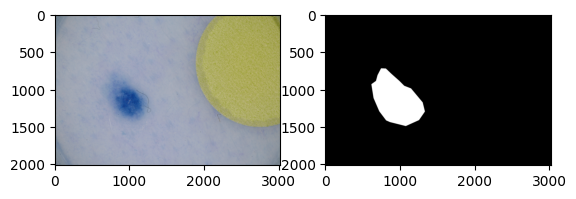

In [10]:
fig, ax = plt.subplots(1,2)
img = cv2.imread(img_paths[0])
mask = cv2.imread(mask_paths[0])
ax[0].imshow(img)
ax[1].imshow(mask)

## Model

Từ yêu cầu bài toán phân đoạn ảnh, em có ý tưởng sử dụng mô hình Unet để giải quyết bài toán. Tuy nhiên mô hình U-net ở đây có chút khác biệt với mô hình Unet gốc: Thay vì không sử dụng padding cho các lớp conv thì em sử dụng padding = 1 cho mỗi lớp conv trừ lớp conv cuối cùng của mô hình để khi kết hợp với kernel_size = 3 và stride = 1 thì đặc trưng không bị thu nhỏ lại so với đầu vào khi đi qua từng block convolution và hình ảnh sẽ được bảo toàn về kích thước ban đầu khi đi qua các block deconvolution. Trong bài báo có đề cập đến việc cắt ảnh thành các tile và xử lý các tile đó, tuy nhiên em đã làm và thấy rằng nó tiêu tốn rất nhiều ram mà kết quả khi train lại không cải thiện được nhiều.

In [11]:
class Block_conv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Block_conv, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
                               kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(in_channels=out_channels, out_channels=out_channels,
                               kernel_size=3, stride=1, padding=1)
        # If inplace=True, change the value of input tensor. If inplace=False, a new tensor will be created, the original input tensor remains unchanged.
        self.activation1 = nn.ReLU(inplace=False)
        self.activation2 = nn.ReLU(inplace=False)
    def forward(self, x):
        x = self.activation1(self.conv1(x))
        x = self.activation2(self.conv2(x))
        # x = self.pool(x)
        return x

class encode_decode_block(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(encode_decode_block, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
                               kernel_size=3, stride=1, padding=1)
        self.activation = nn.ReLU(inplace=False)
    def forward(self, x):
        return self.activation(self.conv1(x))

class Block_up_sample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Block_up_sample, self).__init__()
        self.up_sample = nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels,
                                            kernel_size=2, stride=2)
    def forward(self, x):
        return self.up_sample(x)

# def crop_center(batch_en_feat, batch_dec_feat):
#     b1, c1, h1, w1 = batch_en_feat.size()
#     b2, c2, h2, w2 = batch_dec_feat.size()
#     h_s = (h1 - h2)//2
#     w_s = (w1 - w2)//2
#     return batch_en_feat[:,:,h_s: (h2+h_s), w_s: (w2 + w_s)]

class Unet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(Unet, self).__init__()
        # encode
        self.en_block1 = Block_conv(in_channels=in_channels, out_channels=64)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.en_block2 = Block_conv(in_channels=64, out_channels=128)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.en_block3 = Block_conv(in_channels=128, out_channels=256)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.en_block4 = Block_conv(in_channels=256, out_channels=512)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.en_block5 = encode_decode_block(in_channels=512, out_channels=1024)
        # decode
        self.de_block5 = encode_decode_block(in_channels=1024, out_channels=1024)
        self.up_sample4 = Block_up_sample(in_channels=1024, out_channels=512)
        self.up_conv4 = Block_conv(in_channels=1024, out_channels=512)

        self.up_sample3 = Block_up_sample(in_channels=512, out_channels=256)
        self.up_conv3 = Block_conv(in_channels=512, out_channels=256)

        self.up_sample2 = Block_up_sample(in_channels=256, out_channels=128)
        self.up_conv2 = Block_conv(in_channels=256, out_channels=128)

        self.up_sample1 = Block_up_sample(in_channels=128, out_channels=64)
        self.up_conv1 = Block_conv(in_channels=128, out_channels=64)

        self.final_conv = nn.Conv2d(in_channels=64, out_channels=out_channels,
                                    kernel_size=1, stride=1, padding=0)
        self.activation = nn.Sigmoid()

    def forward(self, x):
        e1 = self.en_block1(x)

        e2 = self.pool1(e1)
        e2 = self.en_block2(e2)

        e3 = self.pool2(e2)
        e3 = self.en_block3(e3)

        e4 = self.pool3(e3)
        e4 = self.en_block4(e4)

        e5 = self.pool4(e4)
        e5 = self.en_block5(e5)

        d5 = self.de_block5(e5)
        
        d4 = self.up_sample4(d5)
        d4 = torch.cat((e4, d4), dim=1)
        d4 = self.up_conv4(d4)

        d3 = self.up_sample3(d4)
        d3 = torch.cat((e3, d3), dim=1)
        d3 = self.up_conv3(d3)

        d2 = self.up_sample2(d3)
        d2 = torch.cat((e2, d2), dim=1)
        d2 = self.up_conv2(d2)

        d1 = self.up_sample1(d2)
        d1 = torch.cat((e1, d1), dim=1)
        d1 = self.up_conv1(d1)

        res = self.final_conv(d1)
        res = self.activation(res)
        return res

In [13]:
# class Block_conv(nn.Module):
#     def __init__(self, in_channels, out_channels):
#         super(Block_conv, self).__init__()
#         self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
#                                kernel_size=3, stride=1, padding=1)
#         self.conv2 = nn.Conv2d(in_channels=out_channels, out_channels=out_channels,
#                                kernel_size=3, stride=1, padding=1)
#         # If inplace=True, change the value of input tensor. If inplace=False, a new tensor will be created, the original input tensor remains unchanged.
#         self.activation1 = nn.ReLU(inplace=False)
#         self.activation2 = nn.ReLU(inplace=False)
#     def forward(self, x):
#         x = self.activation1(self.conv1(x))
#         x = self.activation2(self.conv2(x))
#         # x = self.pool(x)
#         return x

# class Block_up_sample(nn.Module):
#     def __init__(self, in_channels, out_channels):
#         super(Block_up_sample, self).__init__()
#         self.up_sample = nn.ConvTranspose2d(in_channels=in_channels, out_channels=out_channels,
#                                             kernel_size=2, stride=2)
#     def forward(self, x):
#         return self.up_sample(x)

# class ResnetUnet(nn.Module):
#     def __init__(self, out_channels=1):
#         super(ResnetUnet, self).__init__()
#         resnet = models.resnet152(pretrained=True)
#         for param in resnet.parameters():
#             param.requires_grad = False
#         self.enc1 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu)  # 64 channels
#         self.pool1 = resnet.maxpool
#         self.enc2 = resnet.layer1  # 256 channels
#         self.enc3 = resnet.layer2  # 512 channels
#         self.enc4 = resnet.layer3  # 1024 channels
#         self.enc5 = resnet.layer4  # 2048 channels

#         # decoder
#         self.up4 = Block_up_sample(2048, 1024)
#         self.conv4 = Block_conv(2048, 1024)

#         self.up3 = Block_up_sample(1024, 512)
#         self.conv3 = Block_conv(1024, 512)

#         self.up2 = Block_up_sample(512, 256)
#         self.conv2 = Block_conv(512, 256)

#         self.up1 = Block_up_sample(256, 64)
#         self.conv1 = Block_conv(128, 64)

#         self.up0 = Block_up_sample(64, 3)
#         self.conv0 = Block_conv(6, 3)

#         self.final_conv = nn.Conv2d(3, out_channels, 1)
#         self.activation = nn.Sigmoid()

#     def forward(self, x):
#         e1 = self.enc1(x) # batch x 3 x img_size x img_size -> batch x 64 x img_size/2 x img_size/2
#         e2 = self.enc2(self.pool1(e1))# batch x 64 x img_size/2 x img_size/2 -> batch x 256 x img_size/4 x img_size/4
#         e3 = self.enc3(e2) # batch x 256 x img_size/4 x img_size/4 -> batch x 512 x img_size/8 x img_size/8
#         e4 = self.enc4(e3) # batch x 512 x img_size/8 x img_size/8 -> batch x 1024 x img_size/16 x img_size/16
#         e5 = self.enc5(e4) # batch x 1024 x img_size/16 x img_size/16 -> batch x 2048 x img_size/32 x img_size/32

#         d4 = self.up4(e5) # batch x 2048 x img_size/32 x img_size/32 -> batch x 1024 x img_size/16 x img_size/16
#         d4 = self.conv4(torch.cat([e4, d4], dim=1)) # batch x 1024 x img_size/16 x img_size/16

#         d3 = self.up3(d4) # batch x 1024 x img_size/16 x img_size/16 -> batch x 512 x img_size/8 x img_size/8
#         d3 = self.conv3(torch.cat([e3, d3], dim=1)) # batch x 512 x img_size/8 x img_size/8

#         d2 = self.up2(d3) # batch x 512 x img_size/8 x img_size/8 -> batch x 256 x img_size/4 x img_size/4
#         d2 = self.conv2(torch.cat([e2, d2], dim=1)) # batch x 256 x img_size/4 x img_size/4

#         d1 = self.up1(d2) # batch x 256 x img_size/4 x img_size/4 -> batch x 64 x img_size/2 x img_size/2
#         d1 = self.conv1(torch.cat([e1, d1], dim=1)) # batch x 64 x img_size/2 x img_size/2

#         d0 = self.up0(d1) # batch x 64 x 160 x 160 -> batch x 3 x img_size x img_size
#         d0 = self.conv0(torch.cat([x, d0], dim=1)) # batch x 3 x img_size x img_size

#         out = self.final_conv(d0)
#         return self.activation(out)

## Loss Function

Ở đây em sử dụng kết hợp sử dụng BCELoss và Dice Loss. BCELoss giúp cập nhật gradient ổn định từ đó làm mô hình hội tụ, Dice loss đo lường trực tiếp mức độ giao nhau giữa vùng dự đoán và ground truth và đây cũng là một metric để đánh giá segmentation

In [12]:
class loss_combine:
    def __init__(self, smooth=1e-6, alpha=0.5):
        self.bce_loss = nn.BCELoss()
        self.smooth = smooth
        self.alpha = alpha

    def __call__(self, outputs, targets):
        return self.alpha * self.bce_loss(outputs, targets) + (1 - self.alpha) * self.DiceLoss(outputs, targets)

    def DiceLoss(self, pred, true):
        # pred: (batch_size, 1, height, width)
        # true: (batch_size, 1, height, width)
        pred = torch.sigmoid(pred)
        pred = pred.view(pred.size(0), -1)
        true = true.view(true.size(0), -1)
        intersection = (pred * true).sum(1)
        dice = (1- ((2. * intersection + self.smooth) / (pred.sum(1) + true.sum(1) + self.smooth)))
        return dice.mean()

Do mô hình Unet có 4 sử dụng 4 lần maxpool làm giảm kích thước ảnh đi 1 nửa mỗi lần nên em chọn resize ảnh về kích thước chia hết cho $2^4$, cụ thể ở đây là 320 x 320.
- Với những ảnh có kích thước ban đầu lớn hơn kích thước resize thì sử dụng interpolation là cv2.INTER_AREA để tránh hiện tượng răng cưa
    - Nếu chiều rộng và chiều dài của ảnh gốc chia hết cho ảnh đích: INTER_AREA dựa vào việc chia ảnh ban đầu thành các khối sau đó với mỗi khối lấy giá trị trung bình để làm giá trị của pixel ở ảnh đích.
    - Nếu chiều rộng và chiều dài của ảnh gốc không chia hết cho ảnh đích: kích thước khối được chia sẽ không nguyên và sẽ có những pixel chỉ nằm một phần trong khối, với những pixel đó thì khi tính toán sẽ nhân giá trị của nó với phần trăm nó nằm trong khối. Sau khi đã xác định và tính toán được các pixel không nằm hoàn toàn trong khối thì sẽ cộng các pixel đó với tất cả các pixel nằm hoàn toàn trong khối, sau đó đem chia cho diện tích khối là ra giá trị của pixel ở ảnh đích
- Với những ảnh có kích thước ban đầu nhỏ hơn kích thước resize thì sử dụng interpolation là cv2.INTER_CUBIC để tính giá trị pixel mới (ở đây do ảnh luôn có kích thước > 320 nên không đề cập sâu về interpolation này)
- Vì đây là ảnh da nên em sử dụng ElasticTransform để augment cho ảnh với xác xuất thêm augment cho mỗi ảnh là 50% biểu thị sự co dãn của da

## Dataset class

In [34]:
import os
import cv2
import torch
from torch.utils.data import Dataset, DataLoader
from albumentations import ElasticTransform
from albumentations.core.composition import Compose
import numpy as np
IMG_SIZE = 320
class Dermatology_data(Dataset):
    def __init__(self, Folder_img, Folder_mask, img_size = IMG_SIZE, mode = "train", p=0.5):
        self.Folder_img = Folder_img
        self.Folder_mask = Folder_mask
        self.mode = mode
        self.img_size = (img_size, img_size)
        self.data_paths = self.get_data_paths()
        if self.mode == "train":
            self.data_paths = self.data_paths[:int(len(self.data_paths)*0.8)]
        elif self.mode == "val":
            self.data_paths = self.data_paths[int(len(self.data_paths)*0.8):]
        else:
            self.data_paths = self.data_paths
        self.img_size = (img_size, img_size)
        self.images_masks = []
        self.p = p
        self.get_data()
    def __getitem__(self, index):
        if self.mode == "train" or self.mode == "val":
            img, mask = self.images_masks[index]
            # h, w, c to c, h, w
            img = np.transpose(img, (2, 0, 1))
            mask = np.transpose(mask, (2, 0, 1))
            return img, mask
        img = self.images_masks[index]
        img = np.transpose(img, (2, 0, 1))
        return img
    def __len__(self):
        return len(self.images_masks)
    def origin_len(self):
        return len(self.data_paths)
    def get_data_paths(self):
        data_paths = []
        if self.mode == "train" or self.mode == "val":
            for file_name in os.listdir(self.Folder_img):
                file_name = file_name.split(".")[0]
                data_paths.append([self.Folder_img + "/" + file_name + ".jpg",
                                   self.Folder_mask + "/" + file_name + ".png"])
        else:
            for file_name in os.listdir(self.Folder_img):
                file_name = file_name.split(".")[0]
                data_paths.append(self.Folder_img + "/" + file_name + ".jpg")
        return data_paths
    def get_data(self):
        for data_path in self.data_paths:
            if self.mode == "train" or self.mode == "val":
                # image = io.imread(data_path[0])
                # mask = io.imread(data_path[1])
                image = cv2.imread(data_path[0])
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                mask  = cv2.imread(data_path[1])
                mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
                mask[mask > 0] = 1
                # normalize mask to 0-1
                # mask = mask / 255.0
                # mask is a numpyndarray with shape (height, width), need to convert to (height, width, 1)
                if(image.shape[1] > self.img_size[0]):
                    image = cv2.resize(image, self.img_size, interpolation=cv2.INTER_AREA) # tránh răng cưa
                    mask = cv2.resize(mask, self.img_size, interpolation=cv2.INTER_AREA)
                    # image = resize(image, self.img_size, anti_aliasing=True) # tránh răng cưa
                    # mask = resize(mask, self.img_size, anti_aliasing=True)
                    #
                    if np.random.uniform(0,1) >= self.p:
                        transform = Compose([
                            ElasticTransform(alpha=120, sigma=12, p=1.0),
                            HorizontalFlip(),
                            GaussianBlur(blur_limit=(1, 5)), 
                            RandomBrightnessContrast()
                        ])
                        augmented = transform(image=image, mask=mask)
                        image_aug = augmented["image"]
                        mask_aug = augmented["mask"]
                        # add last dim to mask
                        mask_aug = np.expand_dims(mask_aug, axis=-1)
                        self.images_masks.append([image_aug, mask_aug])
                    # add last dim to mask
                    mask = np.expand_dims(mask, axis=-1)
                    self.images_masks.append([image, mask])
                else:
                    image = cv2.resize(image, self.img_size, interpolation=cv2.INTER_CUBIC) # sử dụng bicubic nội suy tính giá trị pixel mới
                    mask = cv2.resize(mask, self.img_size, interpolation=cv2.INTER_CUBIC)
                    # image = resize(image, self.img_size, order=3) # sử dụng bicubic nội suy tính giá trị pixel mới
                    # mask = resize(mask, self.img_size, order=3)
                    if np.random.uniform(0,1) >= self.p:
                        transform = Compose([
                            ElasticTransform(alpha=120, sigma=12, p=1.0)
                        ])
                        augmented = transform(image=image, mask=mask)
                        image_aug = augmented["image"]
                        mask_aug = augmented["mask"]
                        # add last dim to mask
                        mask_aug = np.expand_dims(mask_aug, axis=-1)
                        self.images_masks.append([image_aug, mask_aug])
                    # add last dim to mask
                    mask = np.expand_dims(mask, axis=-1)
                    self.images_masks.append([image, mask])
            else:
                # image = io.imread(data_path[0])
                image = cv2.imread(data_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                if(image.shape[1] > self.img_size[0]):
                    image = cv2.resize(image, self.img_size, interpolation=cv2.INTER_AREA) # tránh răng cưa
                else:
                    image = cv2.resize(image, self.img_size, interpolation=cv2.INTER_CUBIC) # sử dụng bicubic nội suy tính giá trị pixel mới
                self.images_masks.append(image)


In [35]:
dataset_train = Dermatology_data(folder_img_train_val, folder_mask_train_val, mode='train')
dataset_val = Dermatology_data(folder_img_train_val, folder_mask_train_val, mode='val')
dataloader_train = DataLoader(dataset_train, batch_size=16, shuffle=True)
dataloader_val = DataLoader(dataset_val, batch_size=16, shuffle=False)

# Trainer & Early stop

Để tránh việc tốn quá nhiều thời gian train vô ích nên em đã tạo ra Early_stop để tự động dừng train sau 10 epoch mà loss validation không giảm

In [36]:
class Early_stop:
    def __init__(self, best_loss, current_epoch=0, consider_epochs=10):
        self.stop = False
        self.consider_epochs = consider_epochs
        self.current_epoch = current_epoch
        self.best_loss = best_loss
    def __call__(self, current_loss):
        if current_loss >= self.best_loss:
            self.current_epoch += 1
        else:
            self.current_epoch = 0
            self.best_loss = current_loss
        if self.current_epoch >= self.consider_epochs:
            self.stop = True
            return

In [16]:
class trainner:
    def __init__(self, model, dataloader_train, dataloader_val, optimizer, epochs, device, scheduler):
        self.model = model
        self.dataloader_train = dataloader_train
        self.dataloader_val = dataloader_val
        self.criterion = loss_combine()
        self.criterion_val = loss_combine()
        # self.criterion = nn.BCEWithLogitsLoss()
        self.optimizer = optimizer
        self.epochs = epochs
        self.device = device
        self.best_loss = float('inf')
        self.best_weight = None
        self.best_epoch = 0
        self.scheduler = scheduler
        self.loss_val_list = []
        self.early_stop = Early_stop(float('inf'))
    def train(self):
        self.model.to(self.device)
        for epoch in range(self.epochs):
            self.model.train()
            pbar = tqdm(self.dataloader_train, desc=f"Epoch {epoch+1}/{self.epochs}, learning_rate {self.optimizer.param_groups[0]['lr']}", unit="batch")
            for images, masks in pbar:
                # images: batch_size, 3, 1040, 1040
                # masks: batch_size, 1, 1040, 1040
                images = images/255
                images = images.to(torch.float32)
                masks = masks.to(torch.float32)
                images = images.to(self.device)
                masks = masks.to(self.device)
                self.optimizer.zero_grad()
                outputs = self.model(images)
                loss = self.criterion(outputs, masks)
                loss.backward()
                self.optimizer.step()
                pbar.set_postfix(loss=loss.item())
            loss_validation = self.validate()
            self.loss_val_list.append(loss_validation)
            if loss_validation < self.best_loss:
                self.best_loss = loss_validation
                self.best_weight = self.model.state_dict()
                self.best_epoch = epoch
            self.early_stop(loss_validation)
            if self.early_stop.stop == True:
                break
            self.scheduler.step(loss_validation)
            
    def validate(self):
        loss_list = []
        self.model.eval()
        with torch.no_grad():
            pbar = tqdm(self.dataloader_val, desc="Validation", unit="batch")
            for images, masks in pbar:
                images = images/255
                images = images.to(torch.float32)
                masks = masks.to(torch.float32)
                images = images.to(self.device)
                masks = masks.to(self.device)
                outputs = self.model(images)
                loss = self.criterion_val(outputs, masks)
                loss_list.append(loss.item())
                pbar.set_postfix(loss=loss.item())
        print(f"Validation Loss: {sum(loss_list) / len(loss_list)}")
        return sum(loss_list) / len(loss_list)

In [19]:
# trainer.train()

## Define hyper parameter and train

- Do mô hình Unet ban đầu chỉ đạt được độ chính xác cao nhất vào khoảng 85% nên em đã thay thế decoder của Unet bằng resnet để tăng độ chính xác. Sau nhiều lần thử nghiệm thì em thấy khi sử dụng decoder là resnet18 thì độ chính xác cao nhất khoảng > 89%

In [37]:
# model = Unet()
device = "cuda" if torch.cuda.is_available() else "cpu"
model = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
    activation='sigmoid'
).to(device)
dataloader_train=dataloader_train
dataloader_val=dataloader_val
optimizer = optim.Adam(model.parameters(), lr=0.0001)
criterion = loss_combine()
criterion_val = loss_combine()
epochs=150

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min',
                                                       factor=0.5, patience=3,
                                                       verbose=True)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [38]:
train_1 = trainner(model, dataloader_train, dataloader_val, optimizer, epochs, device, scheduler)

### Training

In [39]:
train_1.train()

Validation: 100%|██████████| 21/21 [00:05<00:00,  4.07batch/s, loss=0.454]


Validation Loss: 0.40672560390971957


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.45] 


Validation Loss: 0.39431023313885644


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.11batch/s, loss=0.453]


Validation Loss: 0.37668860384396147


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.545]


Validation Loss: 0.39039405186971027


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.13batch/s, loss=0.432]


Validation Loss: 0.377611490942183


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.09batch/s, loss=0.44] 


Validation Loss: 0.37717457044692265


Validation: 100%|██████████| 21/21 [00:05<00:00,  3.99batch/s, loss=0.431]


Validation Loss: 0.37944457644508


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.11batch/s, loss=0.429]


Validation Loss: 0.37010715688977924


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.431]


Validation Loss: 0.37402255336443585


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.442]


Validation Loss: 0.3751042045298077


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.01batch/s, loss=0.452]


Validation Loss: 0.3787287033739544


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.447]


Validation Loss: 0.37788244230406626


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.09batch/s, loss=0.447]


Validation Loss: 0.3800719351995559


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.12batch/s, loss=0.447]


Validation Loss: 0.38452827788534616


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.13batch/s, loss=0.451]


Validation Loss: 0.3845848526273455


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.12batch/s, loss=0.452]


Validation Loss: 0.3818599127587818


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.10batch/s, loss=0.454]


Validation Loss: 0.3841818060193743


Validation: 100%|██████████| 21/21 [00:05<00:00,  4.09batch/s, loss=0.464]

Validation Loss: 0.38387576171330046


# 

## Result

In [40]:
train_1.best_loss, train_1.best_epoch

(0.37010715688977924, 7)

In [41]:
# model_load = Unet()
device = "cpu"
model_load = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
    activation='sigmoid'
).to(device)
model_load.load_state_dict(train_1.best_weight)  
model_load = model_load.to(device)             
model_load.eval()

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

### Visualize result

In [42]:
folder_img_test = "/kaggle/input/dataset-image-processing/Dataset/Test/Image/"

In [43]:
dataset_test = Dermatology_data(folder_img_test, "", mode='test')
dataloader_test = DataLoader(dataset_test, batch_size=8, shuffle=False)

In [44]:
import matplotlib.pyplot as plt

/tmp/ipykernel_107/730026076.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 2)


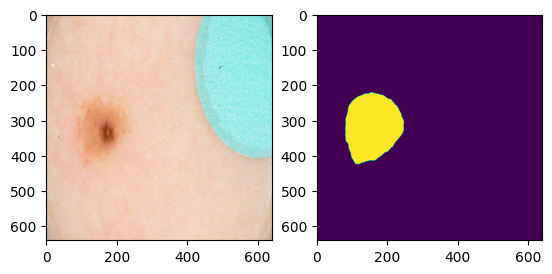

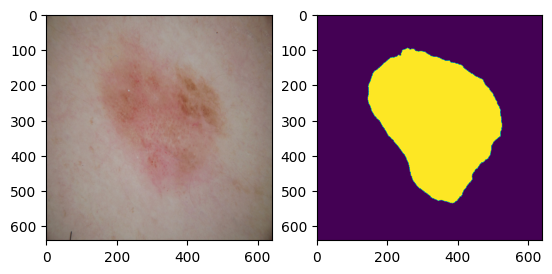

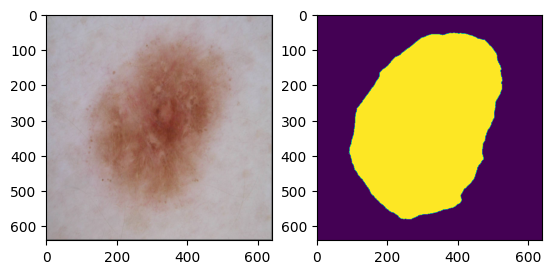

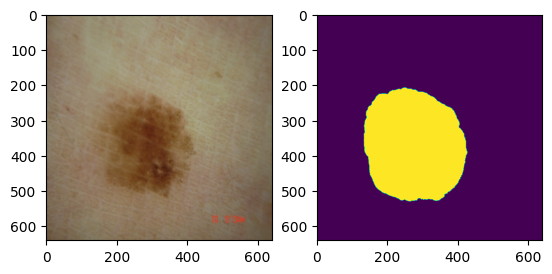

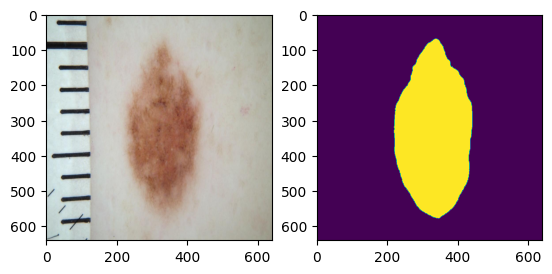

...

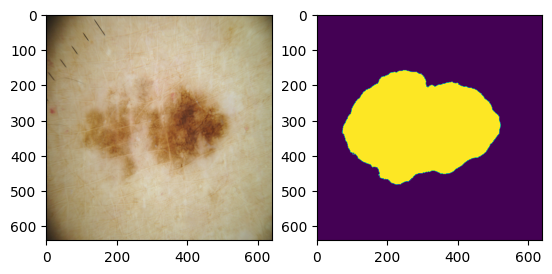

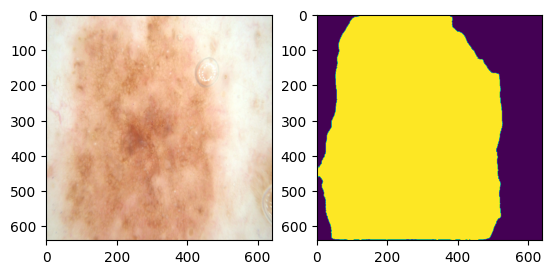

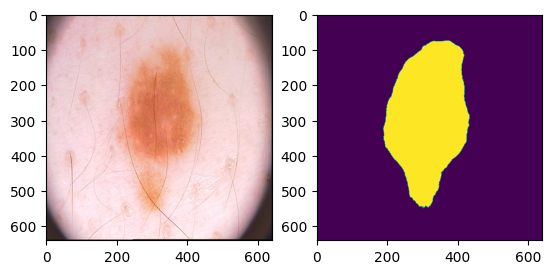

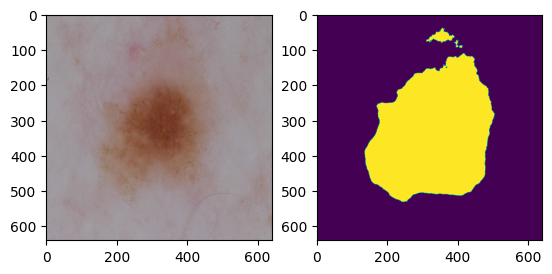

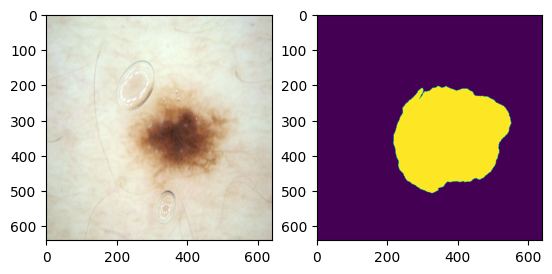

In [45]:
for imgs_raw in dataloader_test:
    imgs_test = imgs_raw/255
    imgs_test = imgs_test.to(torch.float32)
    imgs_test = imgs_test.to(device)
    output = model_load(imgs_test)
    ind=0
    for i in range(1):
        for j in range(8):
            fig, ax = plt.subplots(1, 2)
            img = imgs_raw[ind].cpu().detach().numpy()
            mask = output[ind].cpu().detach().numpy() 
            img = np.transpose(img, (1, 2, 0))
            img = img.astype(np.uint8)
            mask = np.transpose(mask, (1, 2, 0))
            mask [mask >= 0.5] = 1
            mask [mask < 0.5 ] = 0
            ax[0].imshow(img)
            ax[1].imshow(mask)
            ind += 1

In [46]:
# img = imgs_test[0].cpu().detach().numpy()
# mask = output[0].cpu().detach().numpy() 
# img = np.transpose(img, (1, 2, 0))
# mask = np.transpose(mask, (1, 2, 0))

In [47]:
best_weight = train_1.best_weight
torch.save(best_weight, "best_weight_unet1.pth")

### Visualize loss

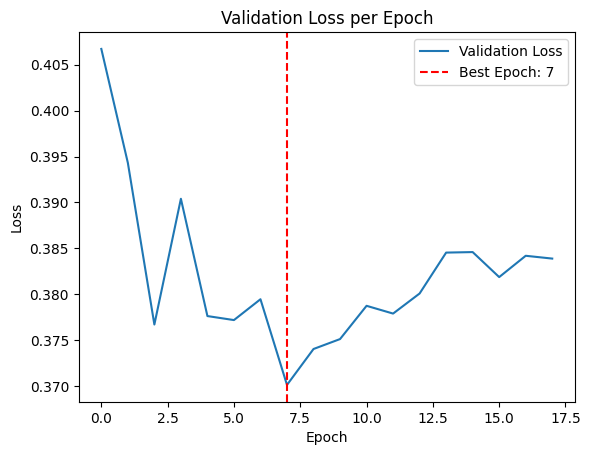

In [48]:
plt.plot(train_1.loss_val_list, label='Validation Loss')
plt.axvline(x=train_1.best_epoch, color='red', linestyle='--', label=f'Best Epoch: {train_1.best_epoch}')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Validation Loss per Epoch')
plt.show()

## Tạo kết quả và lưu ra file csv

In [49]:
folder_img_test = "/kaggle/input/dataset-image-processing/Dataset/Test/Image"
dataset_test = Dermatology_data(folder_img_test, "", mode='test')
dataloader_test = DataLoader(dataset_test, batch_size=2, shuffle=False)

In [50]:
def mask_to_rle(mask):
    pixels = mask.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return " ".join(map(str, runs))

In [51]:
IDs = []
Mask = []
file_submit = "submit_file1.csv"

In [52]:
import os
folder_img_test = "/kaggle/input/dataset-image-processing/Dataset/Test/Image"
for file_name in os.listdir(folder_img_test):
    file_name = file_name.split(".")[0]
    img = cv2.imread(folder_img_test + "/" + file_name + ".jpg")
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    original_width = img.shape[1]
    original_height = img.shape[0]
    if(img.shape[1] > IMG_SIZE):
        img = cv2.resize(img, (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_AREA)
    else:
        img = cv2.resize(img, (IMG_SIZE, IMG_SIZE), interpolation=cv2.INTER_CUBIC)
    img = np.transpose(img, (2, 0, 1))
    img = img/255
    img = torch.from_numpy(img).float()
    img = img.unsqueeze(0)
    img = img.to(device)
    with torch.no_grad():
        pred = model_load(img)
        pred = pred.squeeze(0)
        pred = pred.cpu().numpy()
        pred = np.transpose(pred, (1, 2, 0))
        pred = pred.squeeze(-1)
        pred[pred > 0.5] = 1
        pred[pred <= 0.5] = 0
        pred = pred.astype(np.uint8)
        if (original_width < IMG_SIZE):
            pred = cv2.resize(pred, (original_width, original_height), interpolation=cv2.INTER_AREA)
        else:
            pred = cv2.resize(pred, (original_width, original_height), interpolation=cv2.INTER_CUBIC)
        rle = mask_to_rle(pred)
        IDs.append(file_name)
        Mask.append(rle)


In [53]:
import pandas as pd

In [55]:
submission_df = pd.DataFrame({"ID": IDs, "Mask": Mask})
submission_df.to_csv(file_submit, mode='a', header=True, index=False)